#BIM PROJECT

# Labels

In [ ]:
%pip install Bio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 281.0/281.0 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 48.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.7/46.7 kB 5.9 MB/s eta 0:00:00


In [ ]:
# Import libraries
from Bio import SeqIO
import random
import numpy as np
import matplotlib as plt
# Enable inline plotting and import necessary libraries
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import seaborn as sns
import pandas as pd
# Set plot style for a cleaner visual appearance
#plt.style.use('seaborn')

In [ ]:
def extract_accession(record_id):
    """Extrait l'identifiant d'accession à partir de l'ID de l'en-tête FASTA."""
    parts = record_id.split('|')
    if len(parts) > 1:
        return parts[1]  # L'identifiant d'accession est la deuxième partie
    else:
        return record_id  # Si le format n'est pas standard, retourner l'ID complet

## Datas

In [ ]:
### Sample sequences

# Load all sequences from the FASTA file
seq_file = "PF00881_final.fasta"
sequences = list(SeqIO.parse(seq_file, "fasta"))
print(len(sequences))
n_sample = len(sequences) # number of sequences to sample

# Check if there are at least n_sample sequences
if len(sequences) < n_sample:
    raise ValueError("The file does not contain enough sequences.")

# Randomly select n_sample sequences
sampled_sequences = random.sample(sequences, n_sample)

# Save the extracted sequences to a new file
output_file = "sampled_seqs.fasta"

with open(output_file, "w") as out_f:
    for seq_record in sampled_sequences:
        out_f.write(f">{seq_record.id}\n{str(seq_record.seq)}\n") #to write each seq in a line

print(f"{n_sample} sequences have been extracted and saved in {output_file}.")



### Numerical encoding

aa_num = {
    "-": 0,  # Gap
    "A": 1, "C": 2, "D": 3, "E": 4, "F": 5,
    "G": 6, "H": 7, "I": 8, "K": 9, "L": 10,
    "M": 11, "N": 12, "P": 13, "Q": 14, "R": 15,
    "S": 16, "T": 17, "V": 18, "W": 19, "Y": 20
}

def num_encoding(seq, aa_num):
   """ Encode each amino acid of a given sequence into a number between 0 and 20.
   Parameters:
   - seq (str): Protein sequence consisting of amino acid letters.
   - aa_num (dict): Dictionary mapping amino acids and gaps to numerical values.
   Returns:
   - list[int]: Encoded sequence as a list of integers.
   """

   if any(aa not in aa_num for aa in seq):
      return []  # Ignore sequences with letters not in the dictionary

   seq_num = [aa_num[aa] for aa in seq]
   return seq_num


import numpy as np

def num_matrix(input_file, output_file):
    seqs = []

    with open(output_file, 'w') as o:
        for record in SeqIO.parse(input_file, "fasta"):
            seq_encoded = num_encoding(record.seq, aa_num)  # Encodage

            if seq_encoded:  # Garder uniquement les séquences valides
                o.write(f">{record.id}\n")  # Écrire l'ID
                o.write(f"{record.seq}\n")  # Écrire la séquence originale

                seqs.append(seq_encoded)  # Ajouter à la matrice finale

    return np.array(seqs)  # Retourne la matrice des séquences encodées


num_seq = num_matrix("sampled_seqs.fasta", "samples.fasta")
print(num_seq.shape)

### One hot encoding

def one_hot_encoding(matrix, num_classes=21):
   """
   Convert a numerical matrix into a one-hot encoded 3D matrix using numpy.

   Parameters:
   - matrix (numpy.ndarray): 2D array with numericzlly encoded AA
   - num_classes (int): Number of unique classes (here 21 for amino acids + gap)

   Returns:
   - numpy.ndarray: One-hot encoded sequence matrix
   """
   identity = np.eye(num_classes, dtype=int)  # Create a 21×21 identity matrix
   return identity[matrix]  # Direct indexing for efficiency

one_hot_matrix = one_hot_encoding(num_seq)

one_hot_matrix.shape

#Reshape pour aplatir la dimension des séquences
n_samples, sequence_length, n_features = one_hot_matrix.shape
one_hot_matrix_flattened = one_hot_matrix.reshape(n_samples, sequence_length * n_features)
print(one_hot_matrix.shape)
print(one_hot_matrix_flattened.shape)


fasta_file = "samples.fasta"
sequence_ids = [record.id for record in SeqIO.parse(fasta_file, "fasta")]
print(len(sequence_ids))

106361
106361 sequences have been extracted and saved in sampled_seqs.fasta.
(105711, 167)
(105711, 167, 21)
(105711, 3507)
105711


In [ ]:
from Bio import SeqIO
import pandas as pd

df = pd.DataFrame([
    {"protein_id": extract_accession(record.id), "sequence": str(record.seq)}
    for record in SeqIO.parse("samples.fasta", "fasta")
])

print(df.head())

   protein_id                                           sequence
0  A0A4V2FJK3  --EARSYNGYTDQPVAESELHAIWDLMKWGPTSANQLPARLIWVVS...
1  A0A1H4BWC5  --SRYSVKEFDATKISEADFQQVKDLLRLSPSSINLQPWHFLIADT...
2  A0A2D5TVZ3  --RRRTVRDFTDSPLPRELIENCLKAADTAPSGANQHPWHFVVVED...
3  A0A972F5F8  ISTRRSVRNFTDEIISRETMDELIRFGTMAASARNKQPWAFLVMGK...
4  A0A254NPI6  -KNRRSIYGISKEQASDDKIRELIEQTLHVPSAFNSQSARVVVL-L...


## Kmeans

In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

k = 16
kmeans = KMeans(k)

# Fit the model to the data
kmeans.fit(one_hot_matrix_flattened)

# Predict the cluster labels for the data points
y_kmeans = kmeans.predict(one_hot_matrix_flattened)

KeyboardInterrupt: 

### On PCA

In [ ]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(one_hot_matrix_flattened)

# Couleurs pour chaque cluster
colors = plt.cm.get_cmap('tab20', k);  # Palette de couleurs;

# Affichage de la PCA en 2D
plt.figure(figsize=(10, 7))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y_kmeans, cmap=colors, alpha=0.7)
plt.colorbar(label="Cluster ID")
plt.xlabel("PCA 1")
plt.ylabel("PCA 2")
plt.title("Projection PCA des clusters KMeans")
plt.show()

### On T-sne

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE

# Réduction de dimension avec t-SNE
tsne = TSNE(n_components=2, perplexity=90)
X_embedded = tsne.fit_transform(one_hot_matrix_flattened)

# Visualisation des clusters sur le scatter plot
plt.figure(figsize=(8, 6))
scatter = plt.scatter(X_embedded[:, 0], X_embedded[:, 1], c=y_kmeans, cmap='tab20', s=6)
plt.title("t-SNE visualization of KMeans clusters")
plt.show()

## Labels

In [ ]:
# Dictionary of protein labels for the dataset
# Label : [UniProt IDs
#labels = {'Acg': ['A0R2V4'], 'BluB': ['Q92PC8'], 'lyD': ['Q9DCX8', 'F4KU78', 'Q6PHW0'], 'PnbA': ['A0R6D0', 'X5M410'], 'Unk1': ['A9CIP6', 'P0ACY1'], 'Unk2': ['B8FRE0', 'Q5LDN3'], 'Unk3': ['Q81HL8'], 'Unk6': ['Q8KFI1', 'C9YJD4'], 'TdsD': ['Q9WYL7', 'A9CKT4'], 'Frm2': ['Q81EW9', 'Q9CED0', 'Q8DW21', 'P37261'], 'FbiB': ['P9WP79'], 'SagB': ['Q5LB10', 'Q472T4', 'B8HTZ1', 'Q3MB62'], 'MhqN': ['A0A0H2VHN8', 'P96692', 'U6C5W9', 'B1YG32', 'Q8DVW4'], 'Hub': ['Q7MX99', 'Q180K0', 'Q60049', 'A6LRC1', 'Q8ABC9', 'Q97IT9', 'Q39RS1', 'A0PZS2', 'Q74GM9', 'Q314Q8', 'Q17ZU8', 'Q182R2', 'C9YJL7'], 'NfsA': ['P17117', 'P39605', 'P94424', 'Q87FS7', 'A0A0K0VJM8', 'Q56691', 'Q5L9C9'], 'NfsB': ['Q7BGI8', 'O25608', 'Q01234', 'P46072', 'P15888', 'Q9A120', 'Q5R179', 'A0A0H2UP38', 'P38489'], 'remainder': ['Q9X1S2']}


### Generate the lables' files

In [ ]:
import os
# Dictionary of protein labels for the dataset
# Label : [UniProt IDs]
labels = {"A0R2V4":"Acg", "Q92PC8":"BluB",  "Q9DCX8": "lyD", "F4KU78":"lyD", 'Q6PHW0':"lyD", 'A0R6D0':'PnbA', 'X5M410':'PnbA', 'A9CIP6':'Unk1', 'P0ACY1':'Unk1', 'B8FRE0':'Unk2', 'Q5LDN3':'Unk2', 'Q81HL8':'Unk3', 'Q8KFI1':'Unk6', 'C9YJD4':'Unk6', 'Q9WYL7':'TdsD', 'A9CKT4':'TdsD', 'Q81EW9':'Frm2', 'Q9CED0':'Frm2', 'Q8DW21':'Frm2', 'P37261':'Frm2', 'P9WP79':'FbiB', 'Q5LB10':'SagB', 'Q472T4':'SagB', 'B8HTZ1':'SagB', 'Q3MB62':'SagB', 'A0A0H2VHN8':'MhqN', 'P96692':'MhqN', 'U6C5W9':'MhqN', 'B1YG32':'MhqN', 'Q8DVW4':'MhqN', 'Q7MX99': 'Hub', 'Q180K0': 'Hub', 'Q60049': 'Hub', 'A6LRC1': 'Hub', 'Q8ABC9': 'Hub', 'Q97IT9': 'Hub', 'Q39RS1': 'Hub', 'A0PZS2': 'Hub', 'Q74GM9': 'Hub', 'Q314Q8': 'Hub', 'Q17ZU8': 'Hub', 'Q182R2': 'Hub', 'C9YJL7': 'Hub', 'P17117': 'NfsA', 'P39605': 'NfsA', 'P94424': 'NfsA', 'Q87FS7': 'NfsA', 'A0A0K0VJM8': 'NfsA', 'Q56691': 'NfsA', 'Q5L9C9': 'NfsA', 'Q7BGI8': 'NfsB', 'O25608': 'NfsB', 'Q01234': 'NfsB', 'P46072': 'NfsB', 'P15888': 'NfsB', 'Q9A120': 'NfsB', 'Q5R179': 'NfsB', 'A0A0H2UP38': 'NfsB', 'P38489': 'NfsB', 'Q9X1S2':'remainder'}
#path = r"C:/Users/sofia/Documents/M1-BIM/BIM_Project/BIM_Project/labels/"
path = r"labels/"
def extract_accession(record_id):
    """Extrait l'identifiant d'accession à partir de l'ID de l'en-tête FASTA."""
    parts = record_id.split('|')
    if len(parts) > 1:
        return parts[2]  # L'identifiant d'accession est la deuxième partie
    else:
        return record_id  # Si le format n'est pas standard, retourner l'ID complet

file = 'label_seqs_final.fasta'

def generate_labels_file(labels, seqs_file, output_dir=path):
   dico_files_label = {}
   if not os.path.exists(output_dir):
        os.makedirs(output_dir)
   with open(seqs_file, 'r') as f:
      lines = f.readlines()
      for i in range(len(lines)-1):
         if lines[i][0].startswith('>'):
            id = extract_accession(lines[i][1:])
            label = labels[id]
            # Créer le fichier avec le label comme nom
            label_file_path = os.path.join(output_dir, f'{label}.fasta')
            dico_files_label[label] = f'{label}.fasta'
            # Écrire la séquence associée dans le fichier correspondant
            with open(label_file_path, 'a') as label_file:
               label_file.write(lines[i] + lines[i + 1])  # Ajouter la ligne d'ID et la séquence
   return dico_files_label
dico_files_label = generate_labels_file(labels, file)

#### K-means projection on PCA + labled sequences

<ipython-input-7-8723f1212988>:45: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab20', 16);  # Palette de couleurs;


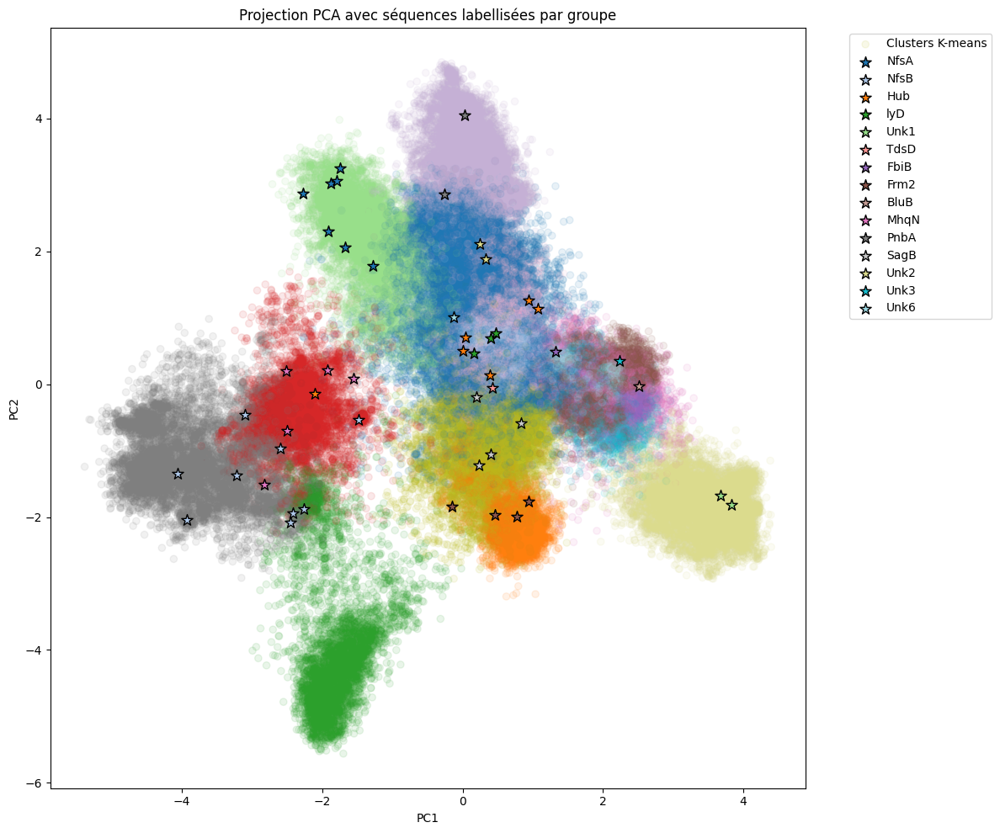

In [ ]:
from sklearn.decomposition import PCA

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Kmeans
k = 16
kmeans = KMeans(k)
kmeans.fit(one_hot_matrix_flattened)
y_kmeans = kmeans.predict(one_hot_matrix_flattened)

# PCA 2d for visualization
pca = PCA(n_components=2)
X_pca = pca.fit_transform(one_hot_matrix_flattened)



# Charger les séquences initiales (celles utilisées pour la PCA)
initial_sequences = [str(record.seq) for record in SeqIO.parse("samples.fasta", "fasta")]

# dictionnaire avec le nom des fichiers fastas pour chaque label
label_files = {'NfsA': 'NfsA.fasta', 'NfsB': 'NfsB.fasta', 'Hub': 'Hub.fasta', 'lyD': 'lyD.fasta', 'Unk1': 'Unk1.fasta', 'TdsD': 'TdsD.fasta', 'FbiB': 'FbiB.fasta', 'Frm2': 'Frm2.fasta', 'BluB': 'BluB.fasta', 'MhqN': 'MhqN.fasta', 'PnbA': 'PnbA.fasta', 'SagB': 'SagB.fasta', 'Unk2': 'Unk2.fasta', 'Unk3': 'Unk3.fasta', 'Unk6': 'Unk6.fasta'}

# Initialiser un dictionnaire pour stocker les coordonnées PCA par label
label_coordinates = {}
label_ids = {}

# Parcourir chaque fichier label
for label, filepath in label_files.items():
    # Lire les séquences du fichier label
    label_seqs = [str(record.seq) for record in SeqIO.parse(path+filepath, "fasta")]

    # Trouver les indices des séquences communes avec les données initiales
    common_indices = [i for i, seq in enumerate(initial_sequences) if seq in label_seqs]

    # Stocker les coordonnées PCA et les IDs des séquences communes
    if common_indices:
        label_coordinates[label] = X_pca[common_indices]  # pca_results = sortie de PCA.fit_transform()
        label_ids[label] = [initial_sequences[i] for i in common_indices]  # Optionnel: pour l'annotation

# 2. Visualisation avec couleurs par label
plt.figure(figsize=(12, 10))

# Afficher les clusters initiaux (ex: K-means)
colors = plt.cm.get_cmap('tab20', 16);  # Palette de couleurs;
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y_kmeans, alpha=0.1, cmap=colors, label="Clusters K-means")

# Afficher les séquences labellisées avec une couleur par label
colors = plt.cm.tab20(np.linspace(0, 1, len(label_files)))  # Palette de 16 couleurs
for (label, coords), color in zip(label_coordinates.items(), colors):
    plt.scatter(coords[:, 0], coords[:, 1], color=color, marker='*', s=100, label=label, edgecolors='black')

# Ajouter une légende et des labels
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("Projection PCA avec séquences labellisées par groupe")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')  # Légende externe
plt.tight_layout()
plt.show()

In [ ]:
from sklearn.decomposition import PCA

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Kmeans
k = 16
kmeans = KMeans(k)
kmeans.fit(one_hot_matrix_flattened)
y_kmeans = kmeans.predict(one_hot_matrix_flattened)

# PCA 2d for visualization
pca = PCA(n_components=2)
X_pca = pca.fit_transform(one_hot_matrix_flattened)



# Charger les séquences initiales (celles utilisées pour la PCA)
initial_sequences = list[df['sequence']]

# dictionnaire avec le nom des fichiers fastas pour chaque label
label_files = {'NfsA': 'NfsA.fasta', 'NfsB': 'NfsB.fasta', 'Hub': 'Hub.fasta', 'lyD': 'lyD.fasta', 'Unk1': 'Unk1.fasta', 'TdsD': 'TdsD.fasta', 'FbiB': 'FbiB.fasta', 'Frm2': 'Frm2.fasta', 'BluB': 'BluB.fasta', 'MhqN': 'MhqN.fasta', 'PnbA': 'PnbA.fasta', 'SagB': 'SagB.fasta', 'Unk2': 'Unk2.fasta', 'Unk3': 'Unk3.fasta', 'Unk6': 'Unk6.fasta'}

# Initialiser un dictionnaire pour stocker les coordonnées PCA par label
label_coordinates = {}
label_ids = {}

# Parcourir chaque fichier label
for label, filepath in label_files.items():
    # Lire les séquences du fichier label
    label_seqs = [str(record.seq) for record in SeqIO.parse(path+filepath, "fasta")]

    # Trouver les indices des séquences communes avec les données initiales
    common_indices = [i for i, seq in enumerate(initial_sequences) if seq in label_seqs]

    # Stocker les coordonnées PCA et les IDs des séquences communes
    if common_indices:
        label_coordinates[label] = X_pca[common_indices]  # pca_results = sortie de PCA.fit_transform()
        label_ids[label] = [initial_sequences[i] for i in common_indices]  # Optionnel: pour l'annotation

# 2. Visualisation avec couleurs par label
plt.figure(figsize=(12, 10))

# Afficher les clusters initiaux (ex: K-means)
colors = plt.cm.get_cmap('tab20', 16);  # Palette de couleurs;
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y_kmeans, alpha=0.1, cmap=colors, label="Clusters K-means")

# Afficher les séquences labellisées avec une couleur par label
colors = plt.cm.tab20(np.linspace(0, 1, len(label_files)))  # Palette de 16 couleurs
for (label, coords), color in zip(label_coordinates.items(), colors):
    plt.scatter(coords[:, 0], coords[:, 1], color=color, marker='*', s=100, label=label, edgecolors='black')

# Ajouter une légende et des labels
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("Projection PCA avec séquences labellisées par groupe")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')  # Légende externe
plt.tight_layout()
plt.show()

#### K-means initialized with centroids of each label

In [ ]:
def define_centroide(file):
    from Bio.Phylo.TreeConstruction import DistanceCalculator
    from Bio import AlignIO
    import numpy as np

    # Charger l'alignement
    alignment = AlignIO.read(file, "fasta")

    # Convertir l'alignement en liste pour un accès simplifié
    alignment_list = list(alignment)

    # Calculer la matrice de distances
    calculator = DistanceCalculator("identity")
    distance_matrix = calculator.get_distance(alignment)

    # Extraire les noms des séquences
    sequence_names = distance_matrix.names

    # Trouver l'index du centroïde
    distances = np.array([distance_matrix[name] for name in sequence_names])
    mean_distances = np.mean(distances, axis=1)
    centroid_index = np.argmin(mean_distances)

    # Récupérer l'enregistrement correspondant au centroïde
    centroid_record = alignment_list[centroid_index]

    return centroid_record.id, str(centroid_record.seq)

#print(define_centroide(path+"NfsA.fasta"))

In [ ]:
# compute the centroids of each label
centroids = {}
# dictionnaire avec le nom des fichiers fastas pour chaque label
label_files = {'NfsA': 'NfsA.fasta', 'NfsB': 'NfsB.fasta', 'Hub': 'Hub.fasta', 'lyD': 'lyD.fasta', 'Unk1': 'Unk1.fasta', 'TdsD': 'TdsD.fasta', 'FbiB': 'FbiB.fasta', 'Frm2': 'Frm2.fasta', 'BluB': 'BluB.fasta', 'MhqN': 'MhqN.fasta', 'PnbA': 'PnbA.fasta', 'SagB': 'SagB.fasta', 'Unk2': 'Unk2.fasta', 'Unk3': 'Unk3.fasta', 'Unk6': 'Unk6.fasta'}
for label, filepath in label_files.items():
    label_seqs = [record for record in SeqIO.parse(path + filepath, "fasta")]  # Garder les objets SeqRecord pour accéder à l'ID
    if len(label_seqs) == 1:

        centroids[label] = [label_seqs[0].id, str(label_seqs[0].seq)]
    else:
      centroids[label] = list(define_centroide(path+filepath))

print(centroids)

{'NfsA': ['48|sp|Q56691|FRP_VIBHA', '-LAHRSIRKFTAVPITDEQRQTIIQAGLAASSSSMLQVVSIVRVTDSEKRNELAQFAGNQAYVESAAEFLVFCIDYQRHATINPDVQADFTELTLI------------------GAVDSGIMAQNCLLAAESMGLGGVYIGGLRNSAVDELLGLPESAVLFGMCLGH'], 'NfsB': ['54|sp|P15888|NFSB_SALTY', '-LQRYSTKAFDPSKLTAEEADKIKTLLQYSPSSTNSQPWHFIVASTEEGKARVAKSAAGNYTFNERKMLDASHVV----VFCAKTAMDDAWLERVVRRFFADMHRVSLKDDHQWMAKQVYLNVGNFLLGVAAMGLDAVPIEGFDAEVLDAEFGLKKYTSLVVVPVGH'], 'Hub': ['36|tr|Q39RS1|Q39RS1_GEOMG', 'IRTRRSVRKFSDRPVEPEKLRAVLDAARLAPSWANMQCWRFVVVEDQATKVQISELSYVEAYFGPKGYKS----------NPAQKALAEAPVVIIA---CGEPPQSGELRGQQYYLTDVGIAAQNLMLAAHDLGLGSVFVGVFDEQQLGELLGIPALRIVGLFPLGY'], 'lyD': ['04|sp|Q6PHW0|IYD1_HUMAN', '-NKRRSVRFISNEQVPMEVIDNVIRTAGTAPSGAHTEPWTFVVVKDPDVKHKIRKIIEEEEEINYMKRMGHRWVTDLLRTNWIKEYLDTAPILILIFKQVHGFAANGKKKVHYYNEISVSIACGILLAALQNAGLVTVTTTPLNGPRLRVLLGRPAEKLLMLLPVGY'], 'Unk1': ['07|tr|A9CIP6|A9CIP6_AGRFC', '---RRSTPALQSEPPSKGEIEEILRLAVRVPDHGKLAPWRFVVY-RGEERVRLSEAALRIALEKNPDLDLQQQ-------EAERTRFTRAPVVIAV-----ISTAKPHKIPEWEQVMSAGAVCLNVIFA

générer une matrice qui contient le one_hot_encoding des centroids

In [ ]:
one_hot_centroids = {}
for label, seq in centroids.items():
  one_hot_centroids[label] = one_hot_encoding(num_encoding(seq[1], aa_num))

In [ ]:

# 1. Préparation des centroïdes
labels = sorted(one_hot_centroids.keys())
initial_centers = np.array([one_hot_centroids[label] for label in labels])
initial_centers_flat = initial_centers.reshape(len(labels), -1)

# 3. K-means
kmeans = KMeans(
    n_clusters=len(labels),
    init=initial_centers_flat,
    n_init=1,
    random_state=42
)
kmeans_initialized = kmeans.fit(one_hot_matrix_flattened)


In [ ]:
import shutil
#shutil.rmtree("labels")

<ipython-input-13-5d40d2405a7c>:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab20', n_clusters)  # Color palette


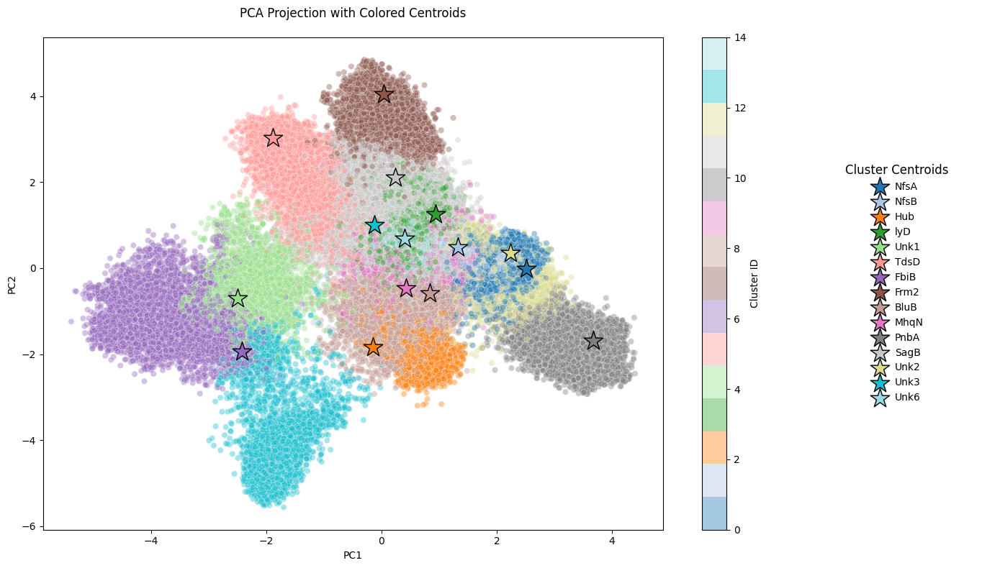

In [ ]:
# 2. Color preparation
n_clusters = len(one_hot_centroids)
colors = plt.cm.get_cmap('tab20', n_clusters)  # Color palette

# 3. Create figure with two subplots (main plot and legend)
fig, (ax, legend_ax) = plt.subplots(1, 2, figsize=(14, 8),
                          gridspec_kw={'width_ratios': [4, 1]})

# 4. Plot data points with cluster colors
# PCA 2d for visualization
pca = PCA(n_components=2)
X_pca = pca.fit_transform(one_hot_matrix_flattened)

scatter = ax.scatter(X_pca[:, 0], X_pca[:, 1],
                    c=kmeans_initialized.labels_,
                    cmap=colors,
                    alpha=0.4,
                    edgecolors='w',
                    linewidths=0.5)

# 5. Plot centroids with matching colors and labels
centroid_handles = []
labels = list(one_hot_centroids.keys())

for i, (center, label) in enumerate(zip(initial_centers_flat, labels)):
    center_2d = pca.transform(center.reshape(1, -1))
    handle = ax.scatter(center_2d[:, 0], center_2d[:, 1],
                       marker='*',
                       s=400,
                       c=[colors(i)],
                       edgecolors='black',
                       linewidths=1)
    centroid_handles.append(handle)

# 6. Create dedicated legend
legend_ax.axis('off')  # Hide axes for legend subplot
legend = legend_ax.legend(centroid_handles, labels,
                         title="Cluster Centroids",
                         loc='center',
                         frameon=False,
                         handletextpad=0.5)

# Adjust legend font size
plt.setp(legend.get_title(), fontsize=12)
plt.setp(legend.get_texts(), fontsize=10)

# 7. Colorbar for clusters
cbar = plt.colorbar(scatter, ax=ax, label='Cluster ID')
cbar.ax.tick_params(labelsize=10)

# 8. Labels and titles
ax.set_title('PCA Projection with Colored Centroids', pad=20)
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')

plt.tight_layout()
plt.show()

Check if labeled sequence fall in the right cluster after k-means

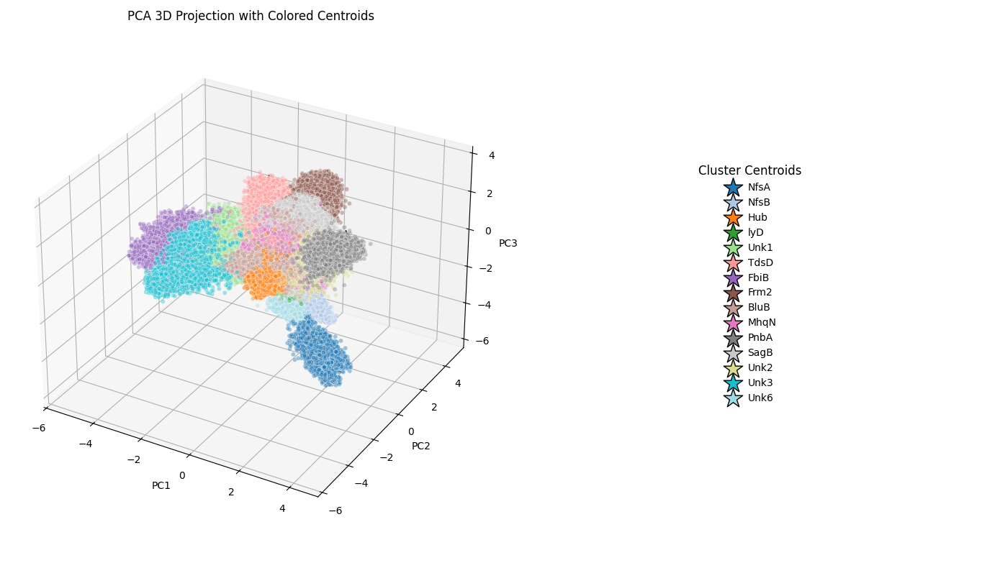

In [ ]:
from mpl_toolkits.mplot3d import Axes3D  # pour 3D
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# 2. Color preparation
n_clusters = len(one_hot_centroids)
colors = plt.cm.get_cmap('tab20', n_clusters); # Color palette

# 4. PCA en 3D
pca = PCA(n_components=3)
X_pca = pca.fit_transform(one_hot_matrix_flattened)

# 3. Create figure with subplots (main 3D plot and legend)
fig = plt.figure(figsize=(14, 8))

# Créer un subplot 3D + un subplot pour la légende
ax = fig.add_subplot(1, 2, 1, projection='3d')  # Subplot 3D
legend_ax = fig.add_subplot(1, 2, 2)            # Subplot légende



# 5. Plot des points avec couleurs des clusters
scatter = ax.scatter(X_pca[:, 0], X_pca[:, 1], X_pca[:, 2],
                     c=kmeans_initialized.labels_,
                     cmap=colors,
                     alpha=0.4,
                     edgecolors='w',
                     linewidths=0.5)

# 6. Affichage des centroïdes en 3D
centroid_handles = []
labels = list(one_hot_centroids.keys())

for i, (center, label) in enumerate(zip(initial_centers_flat, labels)):
    center_3d = pca.transform(center.reshape(1, -1))
    handle = ax.scatter(center_3d[:, 0], center_3d[:, 1], center_3d[:, 2],
                        marker='*',
                        s=400,
                        c=[colors(i)],
                        edgecolors='black',
                        linewidths=1,
                        label = label)
    centroid_handles.append(handle)

# 7. Légende dédiée
legend_ax.axis('off')
legend = legend_ax.legend(centroid_handles, labels,
                          title="Cluster Centroids",
                          loc='center',
                          frameon=False,
                          handletextpad=0.5)
plt.setp(legend.get_title(), fontsize=12)
plt.setp(legend.get_texts(), fontsize=10)

# 8. Titre et axes
ax.set_title('PCA 3D Projection with Colored Centroids', pad=20)
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')

plt.tight_layout()
plt.show()


<ipython-input-30-808fa2cb5ded>:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab20', n_clusters)


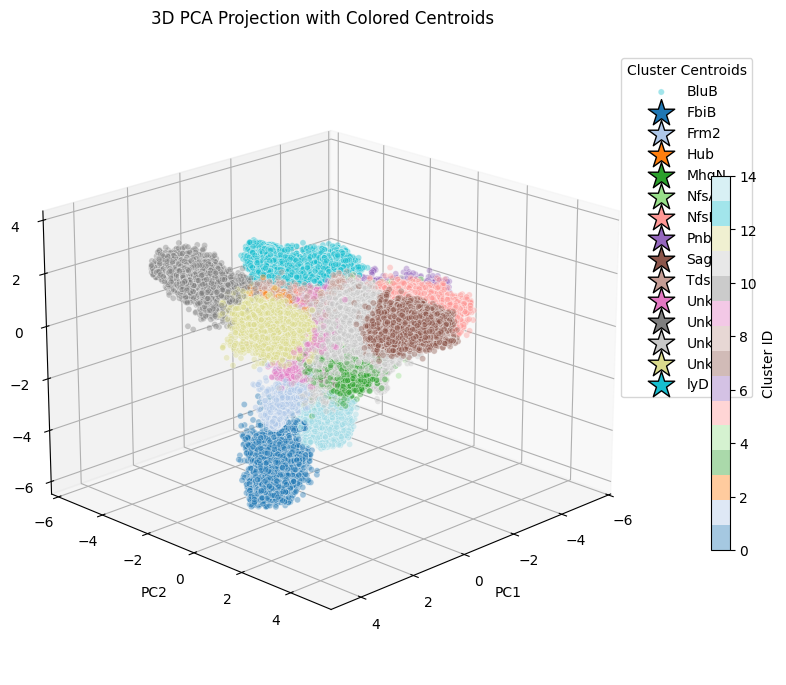

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

# 1. PCA 3D pour la visualisation
pca = PCA(n_components=3)
X_pca = pca.fit_transform(one_hot_matrix_flattened)

# 2. Création de la figure 3D
fig = plt.figure(figsize=(16, 10))
ax = fig.add_subplot(111, projection='3d')

# 3. Paramètres visuels
colors = plt.cm.get_cmap('tab20', n_clusters)
centroid_colors = [colors(i) for i in range(n_clusters)]

# 4. Plot des points avec couleurs de cluster
scatter = ax.scatter(
    X_pca[:, 0], X_pca[:, 1], X_pca[:, 2],
    c=kmeans_initialized.labels_,
    cmap=colors,
    alpha=0.4,
    edgecolors='w',
    linewidths=0.5,
    depthshade=True
)

# 5. Plot des centroïdes
centroid_pca = pca.transform(initial_centers_flat)
for i, (center, label) in enumerate(zip(centroid_pca, labels)):
    ax.scatter(
        center[0], center[1], center[2],
        marker='*',
        s=400,
        c=[centroid_colors[i]],
        edgecolors='black',
        linewidths=1,
        label=label
    )

# 6. Légende et titres
ax.legend(labels, title="Cluster Centroids", bbox_to_anchor=(1.2, 1))
ax.set_title('3D PCA Projection with Colored Centroids', pad=20)
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')

# 7. Colorbar
cbar = fig.colorbar(scatter, ax=ax, shrink=0.6, aspect=20, label='Cluster ID')
cbar.ax.tick_params(labelsize=10)

# 8. Ajustement de la vue
ax.view_init(elev=20, azim=45)  # Angle de vue initial

plt.tight_layout()
plt.show()

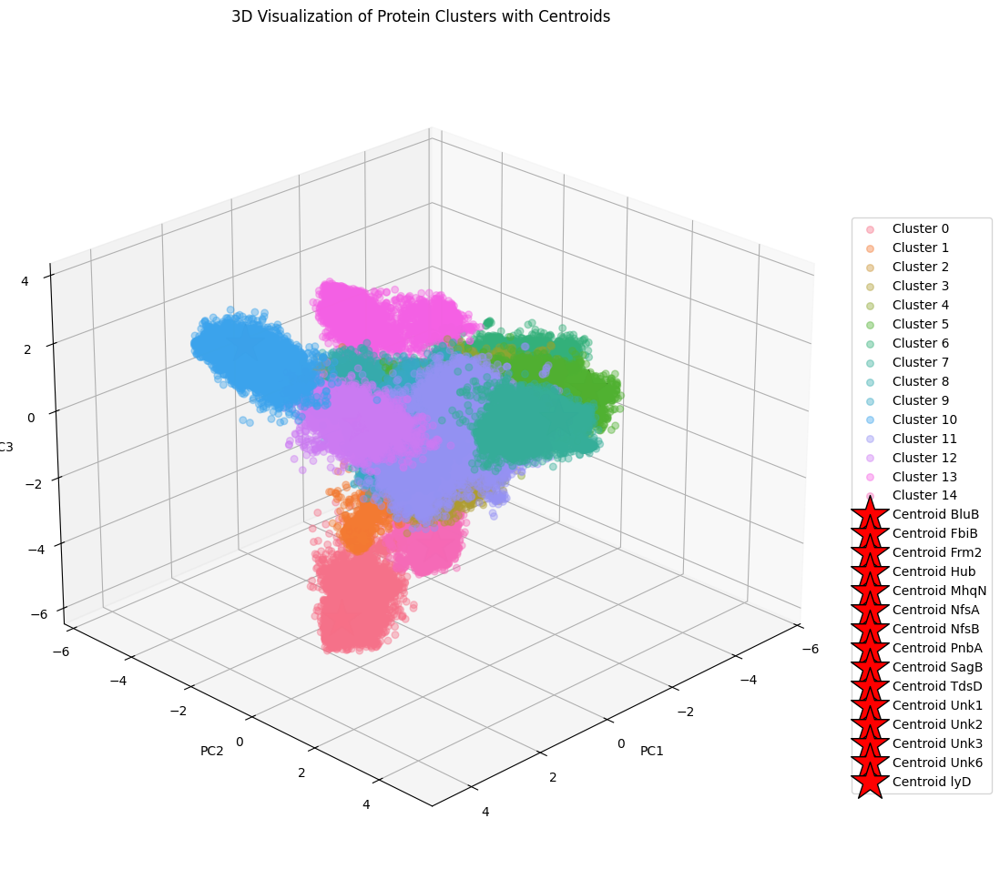

In [ ]:
# 4. Préparation du DataFrame pour Seaborn
import pandas as pd
plot_data = pd.DataFrame({
    'PC1': X_pca[:, 0],
    'PC2': X_pca[:, 1],
    'PC3': X_pca[:, 2],
    'Cluster': kmeans.labels_
})

# 5. Création de la figure 3D
plt.figure(figsize=(15, 10))
ax = plt.subplot(111, projection='3d')

# 6. Palette de couleurs
palette = sns.color_palette("husl", n_colors=len(labels))

# 7. Plot des points avec Seaborn
for cluster, color in zip(range(len(labels)), palette):
    cluster_data = plot_data[plot_data['Cluster'] == cluster]
    ax.scatter(
        cluster_data['PC1'],
        cluster_data['PC2'],
        cluster_data['PC3'],
        color=color,
        alpha=0.4,
        s=30,
        label=f'Cluster {cluster}'
    )

# 8. Plot des centroïdes
for i, (centroid, label) in enumerate(zip(centroids_pca, labels)):
    ax.scatter(
        centroid[0], centroid[1], centroid[2],
        marker='*',
        s=500,
        color=palette[i],
        edgecolor='black',
        linewidth=1,
        label=f'Centroid {label}'
    )

# 9. Personnalisation
ax.set_title('3D Visualization of Protein Clusters with Centroids', pad=20)
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')

# 10. Légende améliorée
ax.legend(bbox_to_anchor=(1.2, 0.8), fontsize=10)

# 11. Ajustement de la vue
ax.view_init(elev=25, azim=45)

plt.tight_layout()
plt.show()

Centroïdes initiaux shape: (15, 3507)
Centroïdes finaux shape: (15, 3507)

Coordonnées des centroïdes en 3D:
[[ 2.06994116 -0.09800062 -4.65691385]
 [ 1.83632644  0.16266926 -2.06510897]
 [ 0.69152633 -2.01386187  0.2980074 ]
 [ 0.42220054  0.82422724 -1.17634618]
 [-2.33499698 -0.42445849 -0.46261461]
 [-1.33675572  2.12145396  1.15230618]
 [-3.65707993 -1.19116851 -0.315461  ]
 [ 0.06672672  3.37166315  1.30444732]
 [ 0.37459211 -0.94207665  0.23402033]
 [ 0.55855831  0.01141736  0.15081317]
 [ 3.45555749 -1.83151497  2.63973462]
 [ 0.10280239  1.38785299  0.36514896]
 [ 2.04622839 -0.1646172   0.92264776]
 [-1.81865922 -3.78738654  0.93339352]
 [ 0.48361678  0.56977869 -2.83226037]]


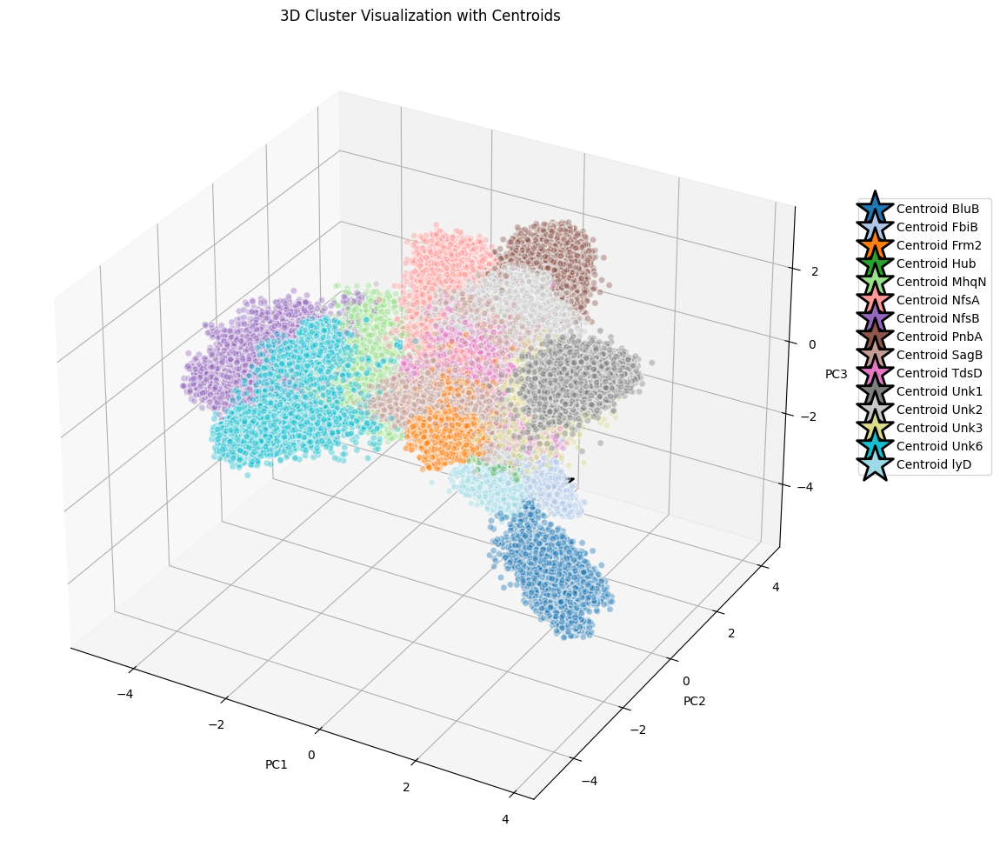

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

# 1. Données (exemple simulé si vos données ne sont pas chargées)
if 'one_hot_matrix_flattened' not in locals():
    np.random.seed(42)
    one_hot_matrix_flattened = np.random.rand(1000, 50)  # Exemple

if 'one_hot_centroids' not in locals():
    labels = ['BluB', 'FbiB', 'Frm2', 'Hub', 'MhqN']
    one_hot_centroids = {label: np.random.rand(50) for label in labels}

# 2. Clustering
labels = sorted(one_hot_centroids.keys())
initial_centers = np.array([one_hot_centroids[label] for label in labels])
initial_centers_flat = initial_centers.reshape(len(labels), -1)

kmeans = KMeans(n_clusters=len(labels), init=initial_centers_flat, n_init=1, random_state=42)
kmeans.fit(one_hot_matrix_flattened)

# 3. Vérification des centroïdes
print("Centroïdes initiaux shape:", initial_centers_flat.shape)
print("Centroïdes finaux shape:", kmeans.cluster_centers_.shape)

# 4. PCA en 3D
pca = PCA(n_components=3)
X_pca = pca.fit_transform(one_hot_matrix_flattened)
centroids_pca = pca.transform(kmeans.cluster_centers_)  # Utilisation des centres FINAUX

# Vérification cruciale
print("\nCoordonnées des centroïdes en 3D:")
print(centroids_pca)

# 5. Visualisation
fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')

# Paramètres visuels
colors = plt.cm.tab20(np.linspace(0, 1, len(labels)))

# Plot des points
scatter = ax.scatter(X_pca[:, 0], X_pca[:, 1], X_pca[:, 2],
                    c=kmeans.labels_,
                    cmap='tab20',
                    alpha=0.4,
                    s=30,
                    edgecolor='w')

# Plot des centroïdes - METHODE GARANTIE
for i, (centroid, label) in enumerate(zip(centroids_pca, labels)):
    # Marqueur géant avec bordure noire
    ax.scatter(*centroid,
               marker='*',
               s=1000,  # Taille augmentée
               color=colors[i],
               edgecolor='black',
               linewidth=2,
               label=f'Centroid {label}')

    # Point supplémentaire pour assurance
    ax.scatter(*centroid,
               marker='o',
               s=100,
               color='red',
               alpha=0.5)

# Ajustements
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
ax.set_title('3D Cluster Visualization with Centroids')

# Légende en dehors
ax.legend(bbox_to_anchor=(1.2, 0.8))

# Ajustement des limites pour voir tous les points
ax.set_xlim(X_pca[:, 0].min(), X_pca[:, 0].max())
ax.set_ylim(X_pca[:, 1].min(), X_pca[:, 1].max())
ax.set_zlim(X_pca[:, 2].min(), X_pca[:, 2].max())

plt.tight_layout()
plt.show()

In [ ]:
import plotly.graph_objects as go
import numpy as np
from sklearn.decomposition import PCA

# 1. Préparation des données (en supposant que vous avez déjà exécuté le K-means)
pca = PCA(n_components=3)
X_pca = pca.fit_transform(one_hot_matrix_flattened)
centroids_pca = pca.transform(kmeans.cluster_centers_)

# 2. Création de la figure interactive
fig = go.Figure()

# 3. Ajout des points avec couleurs par cluster
for cluster in range(len(labels)):
    mask = kmeans.labels_ == cluster
    fig.add_trace(go.Scatter3d(
        x=X_pca[mask, 0],
        y=X_pca[mask, 1],
        z=X_pca[mask, 2],
        mode='markers',
        marker=dict(
            size=4,
            color=cluster,  # Couleur par cluster
            colorscale='Viridis',
            opacity=0.7
        ),
        name=f'Cluster {cluster}',
        hovertext=df['protein_id'][mask] if 'protein_id' in df.columns else None
    ))

# 4. Ajout des centroïdes avec marqueurs visibles
fig.add_trace(go.Scatter3d(
    x=centroids_pca[:, 0],
    y=centroids_pca[:, 1],
    z=centroids_pca[:, 2],
    mode='markers+text',
    marker=dict(
        size=12,
        color='red',
        symbol='diamond'
    ),
    text=labels,
    textposition="top center",
    name='Centroids'
))

# 5. Personnalisation du layout
fig.update_layout(
    title='Interactive 3D Protein Clusters with Centroids',
    scene=dict(
        xaxis_title='PC1',
        yaxis_title='PC2',
        zaxis_title='PC3',
        camera=dict(
            eye=dict(x=1.5, y=1.5, z=0.6)  # Position initiale de la caméra
        )
    ),
    width=1000,
    height=800,
    hovermode='closest'
)

# 6. Fonctionnalités interactives supplémentaires
fig.update_layout(
    updatemenus=[
        dict(
            type="buttons",
            buttons=[
                dict(label="Reset View",
                     method="relayout",
                     args=["scene.camera", dict(eye=dict(x=1.5, y=1.5, z=0.6))]),
                dict(label="Hide Centroids",
                     method="update",
                     args=[{"visible": [True]*len(labels) + [False]}])
            ]
        )
    ]
)

# 7. Affichage
fig.show()

In [ ]:
import plotly.graph_objects as go
import numpy as np
from matplotlib import cm
from matplotlib.colors import to_hex

# 1. Préparation des couleurs
n_clusters = len(labels)
colors = [to_hex(cm.tab20(i)) for i in np.linspace(0, 1, n_clusters)]

# 2. Création de la figure
fig = go.Figure()

# 3. Ajout des points par cluster
for cluster in range(n_clusters):
    mask = kmeans.labels_ == cluster
    fig.add_trace(go.Scatter3d(
        x=X_pca[mask, 0],
        y=X_pca[mask, 1],
        z=X_pca[mask, 2],
        mode='markers',
        marker=dict(
            size=4,
            color=colors[cluster],
            opacity=0.6
        ),
        name=f'Cluster {labels[cluster]}',
        showlegend=True
    ))

# 4. Ajout des centroïdes avec contour noir VISIBLE
for i, (centroid, label) in enumerate(zip(centroids_pca, labels)):
    fig.add_trace(go.Scatter3d(
        x=[centroid[0]],
        y=[centroid[1]],
        z=[centroid[2]],
        mode='markers+text',
        marker=dict(
            size=12,  # Taille augmentée
            color=colors[i],
            opacity=1,
            symbol='diamond',
            line=dict(
                color='black',
                width=100  # Contour épais
            )
        ),
        text=label,
        textposition="top center",
        name=f'Centroid {label}',
        showlegend=False  # On masque de la légende pour éviter la duplication
    ))

# 5. Optimisation de l'affichage
fig.update_layout(
    title='Protein Clusters 3D Visualization',
    scene=dict(
        xaxis_title='PC1',
        yaxis_title='PC2',
        zaxis_title='PC3',
        camera=dict(eye=dict(x=1.5, y=1.5, z=0.6))
    ),
    width=1000,
    height=800,
    hovermode='closest'
)

# 6. Affichage
fig.show()

In [ ]:
import plotly.graph_objects as go
import numpy as np
from matplotlib.colors import to_hex, to_rgb
import colorsys

# 1. Fonction pour assombrir les couleurs
def darken_color(hex_color, factor=0.3):
    rgb = to_rgb(hex_color)
    h, l, s = colorsys.rgb_to_hls(*rgb)
    darker_rgb = colorsys.hls_to_rgb(h, max(0, l * (1 - factor)), s)
    return to_hex(darker_rgb)

# 2. Préparation des couleurs
base_colors = [to_hex(plt.cm.tab20(i)) for i in range(len(labels))]
centroid_colors = [darken_color(c) for c in base_colors]  # Version plus foncée

# 3. Création de la figure
fig = go.Figure()

# 4. Ajout des points (clusters)
for i, color in enumerate(base_colors):
    mask = kmeans.labels_ == i
    fig.add_trace(go.Scatter3d(
        x=X_pca[mask, 0], y=X_pca[mask, 1], z=X_pca[mask, 2],
        mode='markers',
        marker=dict(size=4, color=color, opacity=0.5),
        name=f'Cluster {labels[i]}'
    ))

# 5. Ajout des centroïdes (avec 3 marqueurs superposés pour visibilité)
for i, (centroid, label) in enumerate(zip(centroids_pca, labels)):
    # Ombre noire (en arrière-plan)
    fig.add_trace(go.Scatter3d(
        x=[centroid[0]], y=[centroid[1]], z=[centroid[2]],
        mode='markers',
        marker=dict(size=22, color='black', symbol='circle'),
        showlegend=False, hoverinfo='skip'
    ))

    # Marqueur principal (couleur saturée + contour)
    fig.add_trace(go.Scatter3d(
        x=[centroid[0]], y=[centroid[1]], z=[centroid[2]],
        mode='markers+text',
        marker=dict(
            size=18,
            color=centroid_colors[i],
            symbol='diamond',
            line=dict(color='black', width=3)
        ),
        text=label,
        textposition="top center",
        name=f'Centroid {label}',
        hoverinfo='name+text'
    ))

    # Point blanc central pour contraste
    fig.add_trace(go.Scatter3d(
        x=[centroid[0]], y=[centroid[1]], z=[centroid[2]],
        mode='markers',
        marker=dict(size=6, color='white', symbol='circle'),
        showlegend=False, hoverinfo='skip'
    ))

# 6. Configuration finale
fig.update_layout(
    title='<b>Protein Clusters 3D - Enhanced Centroids</b>',
    scene=dict(
        xaxis_title='PC1',
        yaxis_title='PC2',
        zaxis_title='PC3',
        camera=dict(eye=dict(x=1.5, y=1.5, z=0.6))
    ),
    width=1000,
    height=800,
    hovermode='closest',
    legend=dict(
        itemsizing='constant',
        title_text='Clusters/Centroids'
    )
)

fig.show()

In [ ]:
labels = sorted(one_hot_centroids.keys())
labels_dico = {'Acg': ['A0R2V4'], 'BluB': ['Q92PC8'], 'lyD': ['Q9DCX8', 'F4KU78', 'Q6PHW0'], 'PnbA': ['A0R6D0', 'X5M410'], 'Unk1': ['A9CIP6', 'P0ACY1'], 'Unk2': ['B8FRE0', 'Q5LDN3'], 'Unk3': ['Q81HL8'], 'Unk6': ['Q8KFI1', 'C9YJD4'], 'TdsD': ['Q9WYL7', 'A9CKT4'], 'Frm2': ['Q81EW9', 'Q9CED0', 'Q8DW21', 'P37261'], 'FbiB': ['P9WP79'], 'SagB': ['Q5LB10', 'Q472T4', 'B8HTZ1', 'Q3MB62'], 'MhqN': ['A0A0H2VHN8', 'P96692', 'U6C5W9', 'B1YG32', 'Q8DVW4'], 'Hub': ['Q7MX99', 'Q180K0', 'Q60049', 'A6LRC1', 'Q8ABC9', 'Q97IT9', 'Q39RS1', 'A0PZS2', 'Q74GM9', 'Q314Q8', 'Q17ZU8', 'Q182R2', 'C9YJL7'], 'NfsA': ['P17117', 'P39605', 'P94424', 'Q87FS7', 'A0A0K0VJM8', 'Q56691', 'Q5L9C9'], 'NfsB': ['Q7BGI8', 'O25608', 'Q01234', 'P46072', 'P15888', 'Q9A120', 'Q5R179', 'A0A0H2UP38', 'P38489'], 'remainder': ['Q9X1S2']}
# Dictionnaire {protein_id: label_expérimental} (ex: {'A0R2V4': 'Acg', ...})
protein_to_label = {pid: label for label, pids in labels_dico.items() for pid in pids}

# Ajouter les prédictions de cluster au DataFrame
df['cluster'] = kmeans.labels_  # Ajoute une colonne 'cluster' avec les numéros de cluster

# Filtrer pour ne garder que les séquences labellisées
labelled_df = df[df['protein_id'].isin(protein_to_label.keys())].copy()
labelled_df['true_label'] = labelled_df['protein_id'].map(protein_to_label)  # Ajoute leur vrai label

# Vérifier la correspondance
label_to_cluster = {label: i for i, label in enumerate(sorted(labels))}  # Mapping label → cluster attendu
labelled_df['expected_cluster'] = labelled_df['true_label'].map(label_to_cluster)
labelled_df['is_correct'] = labelled_df['cluster'] == labelled_df['expected_cluster']

# Accuracy
accuracy = labelled_df['is_correct'].mean()
print(f"Precision: \033[1m{accuracy * 100:.2f}%\033[0m  of labelled sequences fall into the cluster initialized with their corresponding centroid.")

Précision: 76.19%  of labelled sequences fall into the cluster initialized with their corresponding centroid.


In [ ]:
labelled_df

,protein_id,sequence,cluster,true_label,expected_cluster,is_correct
625,A9CIP6,---RRSTPALQSEPPSKGEIEEILRLAVRVPDHGKLAPWRFVVY-R...,10,Unk1,10,True
9234,Q9DCX8,-NKRRSVRFISSEHVPMEVIENVIKAAGTAPSGAHTEPWTFVVVKD...,14,lyD,14,True
11295,Q9WYL7,IEWRRARRALKKDRVPREELELLIKAAHLAPSCMNNQPWRFVVVD-...,9,TdsD,9,True
20583,Q8KFI1,----RSIRRFDEHVVNDATLRDLVELVCYTPSAANRQLLRFLPVTG...,11,Unk6,13,False
25808,Q5R179,--WRYATADFSGAHITDDVLDKLLNTTRLTASSYGLQPYCTLVIRN...,6,NfsB,6,True
30395,Q39RS1,IRTRRSVRKFSDRPVEPEKLRAVLDAARLAPSWANMQCWRFVVVED...,9,Hub,3,False
32693,F4KU78,--HRRTVREFSNRAIPLEVIENIVMTASTAPSGAHKQPWTFVVVSD...,14,lyD,14,True
37291,Q182R2,-FKRQSVRKFKNQDVSDEDILKMIKAAGAAPSGKNIQNWHFVVIKR...,11,Hub,3,False
50369,A0A0H2VHN8,--SRKSVKVFDENYIPREEMDEIITKATKAPSSVNMQPWRIAVVQS...,4,MhqN,4,True
52268,A0PZS2,IKKRKSIKKFEQTAIDRDKLLKIIDMAMRAPSWKNKTPYKFIVVES...,9,Hub,3,False


## ESM

#Classifier

## Datas

In [ ]:
from Bio import SeqIO
import random
import numpy as np
import matplotlib as plt
### Numerical encoding

aa_num = {
    "-": 0,  # Gap
    "A": 1, "C": 2, "D": 3, "E": 4, "F": 5,
    "G": 6, "H": 7, "I": 8, "K": 9, "L": 10,
    "M": 11, "N": 12, "P": 13, "Q": 14, "R": 15,
    "S": 16, "T": 17, "V": 18, "W": 19, "Y": 20
}

def num_encoding(seq, aa_num):
   """ Encode each amino acid of a given sequence into a number between 0 and 20.
   Parameters:
   - seq (str): Protein sequence consisting of amino acid letters.
   - aa_num (dict): Dictionary mapping amino acids and gaps to numerical values.
   Returns:
   - list[int]: Encoded sequence as a list of integers.
   """

   if any(aa not in aa_num for aa in seq):
      return []  # Ignore sequences with letters not in the dictionary

   seq_num = [aa_num[aa] for aa in seq]
   return seq_num


import numpy as np

def num_matrix(input_file, output_file):
    seqs = []

    with open(output_file, 'w') as o:
        for record in SeqIO.parse(input_file, "fasta"):
            seq_encoded = num_encoding(record.seq, aa_num)  # Encodage

            if seq_encoded:  # Garder uniquement les séquences valides
                o.write(f">{record.id}\n")  # Écrire l'ID
                o.write(f"{record.seq}\n")  # Écrire la séquence originale

                seqs.append(seq_encoded)  # Ajouter à la matrice finale

    return np.array(seqs)  # Retourne la matrice des séquences encodées

### One hot encoding

def one_hot_encoding(matrix, num_classes=21):
   """
   Convert a numerical matrix into a one-hot encoded 3D matrix using numpy.

   Parameters:
   - matrix (numpy.ndarray): 2D array with numericzlly encoded AA
   - num_classes (int): Number of unique classes (here 21 for amino acids + gap)

   Returns:
   - numpy.ndarray: One-hot encoded sequence matrix
   """
   identity = np.eye(num_classes, dtype=int)  # Create a 21×21 identity matrix
   return identity[matrix]  # Direct indexing for efficiency



**Here we prepare the data:**  One hot matrices, labels, concatenate natural and artificial data

In [ ]:
# This code is to sample datas
"""# Load all sequences from the FASTA file
seq_file = "PF00881_final.fasta"
sequences = list(SeqIO.parse(seq_file, "fasta"))
print(len(sequences))
n_sample = 30000 # number of sequences to sample

# Check if there are at least n_sample sequences
if len(sequences) < n_sample:
    raise ValueError("The file does not contain enough sequences.")

# Randomly select n_sample sequences
sampled_sequences = random.sample(sequences, n_sample)

# Save the extracted sequences to a new file
output_file = "sampled_seqs.fasta"

with open(output_file, "w") as out_f:
    for seq_record in sampled_sequences:
        out_f.write(f">{seq_record.id}\n{str(seq_record.seq)}\n") #to write each seq in a line

print(f"{n_sample} sequences have been extracted and saved in {output_file}.")"""

106361
30000 sequences have been extracted and saved in sampled_seqs.fasta.


In [ ]:
# Natural sequences
natural_one_hot = one_hot_encoding(num_matrix("PF00881_final.fasta", "samples.fasta"))
#natural_one_hot = one_hot_encoding(num_matrix("sampled_seqs.fasta", "samples.fasta"))
n_samples, sequence_length, n_features = natural_one_hot.shape
natural_flattened = natural_one_hot.reshape(n_samples, sequence_length * n_features)

# Artificial sequences
generated_num_seq = num_matrix('generated_nitroreductase_sequences.fasta', "fila.fasta")
generated_one_hot = one_hot_encoding(generated_num_seq)
n_samples, sequence_length, n_features = generated_one_hot.shape
generated_flattened = generated_one_hot.reshape(n_samples, sequence_length * n_features)

# Labels
## natural sequences --> 0
## artificial sequences --> 1
labels_natural = np.zeros(natural_flattened.shape[0])
labels_generated = np.ones(generated_flattened.shape[0])

# Concatenate natural + artificial
X = np.vstack([natural_flattened, generated_flattened])
y = np.hstack([labels_natural, labels_generated])


**Split into train and test**

In [ ]:
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split

X_shuffled, y_shuffled = shuffle(X, y, random_state=42)


X_train, X_test, y_train, y_test = train_test_split(
    X_shuffled, y_shuffled,
    test_size=0.2,
    random_state=42
)

## Logistic regression

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
clf = LogisticRegression()
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy logistic regression: {accuracy*100}%")

Accuracy logistic regression: 96.69639492526065%


### Random forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier

r_forest = RandomForestClassifier()
r_forest.fit(X_train, y_train)
y_pred = r_forest.predict(X_test)
# Évaluation
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy random forest: {accuracy*100}%")


Accuracy random forest: 91.91056399949755%
